In [1]:
pip install scikit-learn

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 9.2/9.2 MB 18.9 MB/s  0:00:00 eta 0:00:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 23.5/23.5 MB 15.4 MB/s  0:00:01 eta 0:00:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4/4 [scikit-learn] [scikit-learn]
Note: you may need to restart the kernel to use updated packages.


In [2]:
!pip install matplotlib

  Using cached contourpy-1.3.3-cp313-cp313-macosx_10_13_x86_64.whl.metadata (5.5 kB)
  Using cached cycler-0.12.1-py3-none-any.whl.metadata (3.8 kB)
  Using cached pillow-11.3.0-cp313-cp313-macosx_10_13_x86_64.whl.metadata (9.0 kB)
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 8.3/8.3 MB 19.5 MB/s  0:00:00m0:00:0100:01
Using cached contourpy-1.3.3-cp313-cp313-macosx_10_13_x86_64.whl (293 kB)
Using cached cycler-0.12.1-py3-none-any.whl (8.3 kB)
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.3/2.3 MB 23.0 MB/s  0:00:00
Using cached pillow-11.3.0-cp313-cp313-macosx_10_13_x86_64.whl (5.3 MB)
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7/7 [matplotlib]7 [matplotlib]


,PC1,PC2,PC3,county_name,survey_year
0,2.181261,-2.938008,-1.134181,"Allegan County, MI",2010
1,-1.601400,-0.364904,1.599695,"Alpena County, MI",2010
2,-1.977708,-0.048803,3.331265,"Antrim County, MI",2010
3,-5.068711,2.719291,-3.823246,"Arenac County, MI",2010
4,-0.428746,-1.228466,-4.888025,"Barry County, MI",2010


Top 10 variables driving PC1:


employment_max       0.236344
employment_mean      0.236210
employment_min       0.236082
unemployment_min     0.235034
unemployment_mean    0.234581
unemployment_max     0.234450
labor_force_max      0.220891
labor_force_mean     0.220683
labor_force_min      0.220412
education_level_4    0.176769
Name: PC1, dtype: float64

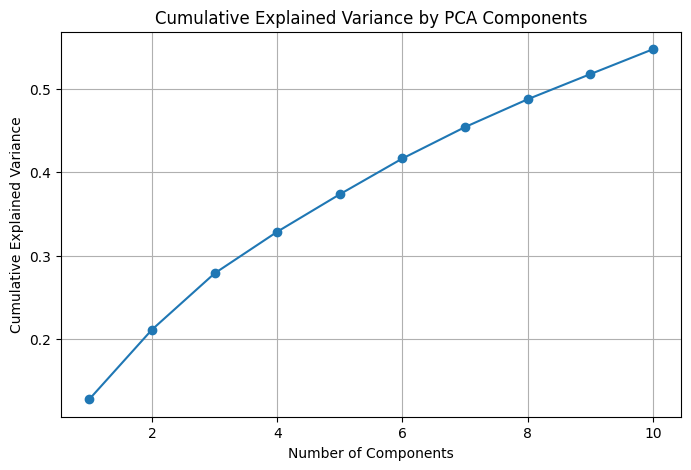

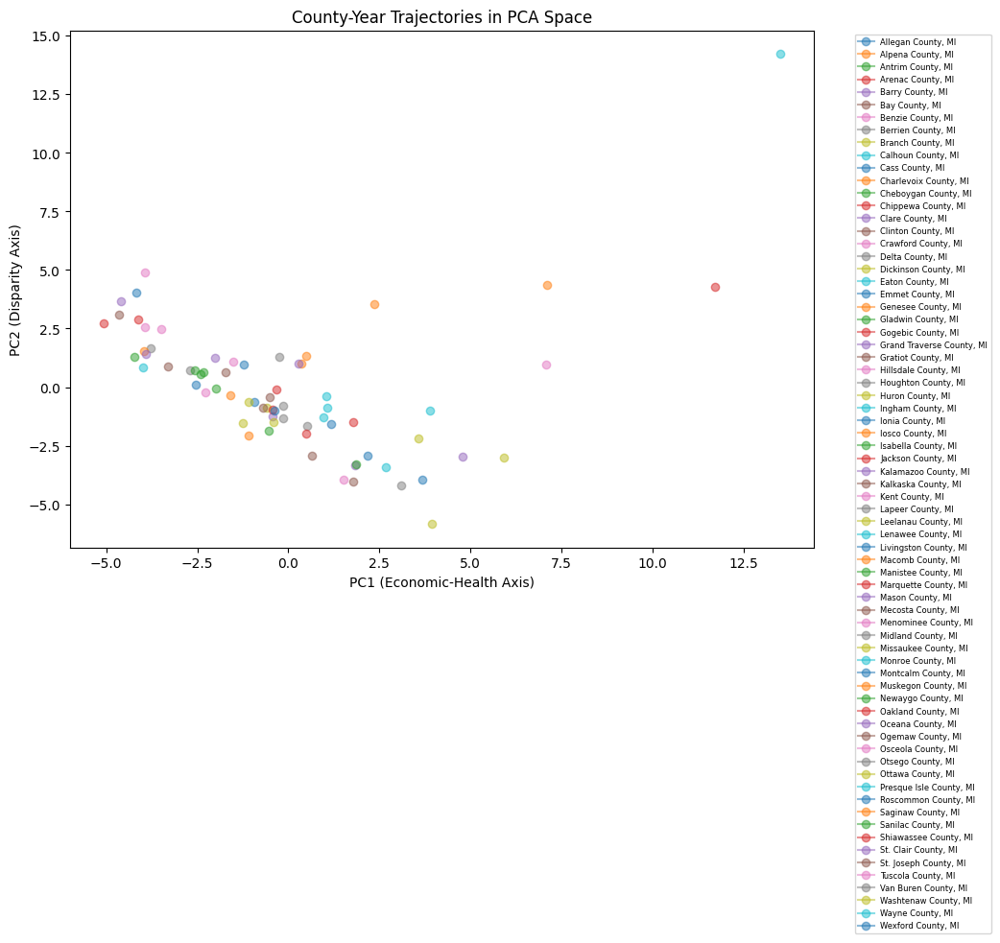

In [3]:
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt
import pandas as pd

# Load dataset
df = pd.read_csv("michigan_health_bls_merged.csv")

# Drop non-numeric columns
X = df.drop(columns=["county_name", "survey_year"])

# Standardize
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Run PCA (keep enough components to explain most variance)
pca = PCA(n_components=10)
X_pca = pca.fit_transform(X_scaled)

# PCA scores (first 3 components)
pca_scores = pd.DataFrame(
    X_pca[:, :3],
    columns=["PC1", "PC2", "PC3"]
)
pca_scores["county_name"] = df["county_name"]
pca_scores["survey_year"] = df["survey_year"]

display(pca_scores.head())

# Loadings: contribution of each variable to each PC
loadings = pd.DataFrame(
    pca.components_.T,
    index=X.columns,
    columns=[f"PC{i+1}" for i in range(pca.n_components_)]
)

print("Top 10 variables driving PC1:")
display(loadings["PC1"].abs().sort_values(ascending=False).head(10))

# Scree plot (variance explained)
plt.figure(figsize=(8,5))
plt.plot(range(1, len(pca.explained_variance_ratio_)+1),
         pca.explained_variance_ratio_.cumsum(), marker="o")
plt.title("Cumulative Explained Variance by PCA Components")
plt.xlabel("Number of Components")
plt.ylabel("Cumulative Explained Variance")
plt.grid(True)
plt.show()

# Scatter plot: county-year trajectories in PCA space
plt.figure(figsize=(10,7))
for county in pca_scores["county_name"].unique():
    subset = pca_scores[pca_scores["county_name"] == county]
    plt.plot(subset["PC1"], subset["PC2"], marker="o", linestyle="-", alpha=0.5, label=county)

plt.title("County-Year Trajectories in PCA Space")
plt.xlabel("PC1 (Economic-Health Axis)")
plt.ylabel("PC2 (Disparity Axis)")
plt.legend(bbox_to_anchor=(1.05, 1), loc="upper left", fontsize=6)
plt.show()

In [4]:
# Tag variables as economic or health
econ_vars = [c for c in X.columns if "employment" in c or "unemployment" in c or "labor_force" in c]
health_vars = [c for c in X.columns if c not in econ_vars]

# Average absolute loadings by group
group_loadings = pd.DataFrame({
    "Economic": loadings.loc[econ_vars].abs().mean(),
    "Health": loadings.loc[health_vars].abs().mean()
})

print(group_loadings)

      Economic    Health
PC1   0.145532  0.059874
PC2   0.141471  0.061010
PC3   0.054440  0.086689
PC4   0.035418  0.088508
PC5   0.065672  0.077557
PC6   0.044026  0.086690
PC7   0.051778  0.089165
PC8   0.038332  0.093605
PC9   0.055432  0.076531
PC10  0.074302  0.081347


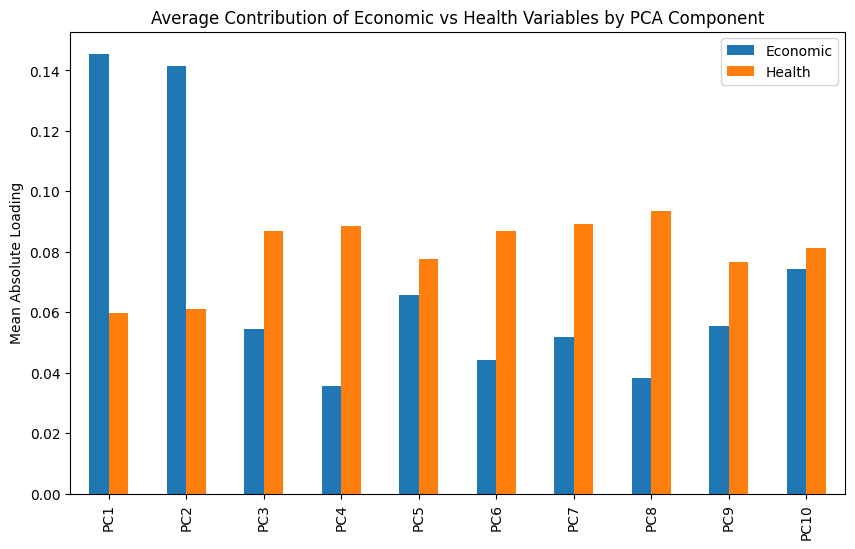

In [5]:
group_loadings.plot(kind="bar", figsize=(10,6))
plt.title("Average Contribution of Economic vs Health Variables by PCA Component")
plt.ylabel("Mean Absolute Loading")
plt.show()

In [6]:
# Correlation between health and economic PCs
corr = pca_scores[["PC1","PC2","PC3"]].corr()
print(corr)

              PC1           PC2           PC3
PC1  1.000000e+00 -1.734337e-16 -1.652757e-16
PC2 -1.734337e-16  1.000000e+00  1.832018e-16
PC3 -1.652757e-16  1.832018e-16  1.000000e+00


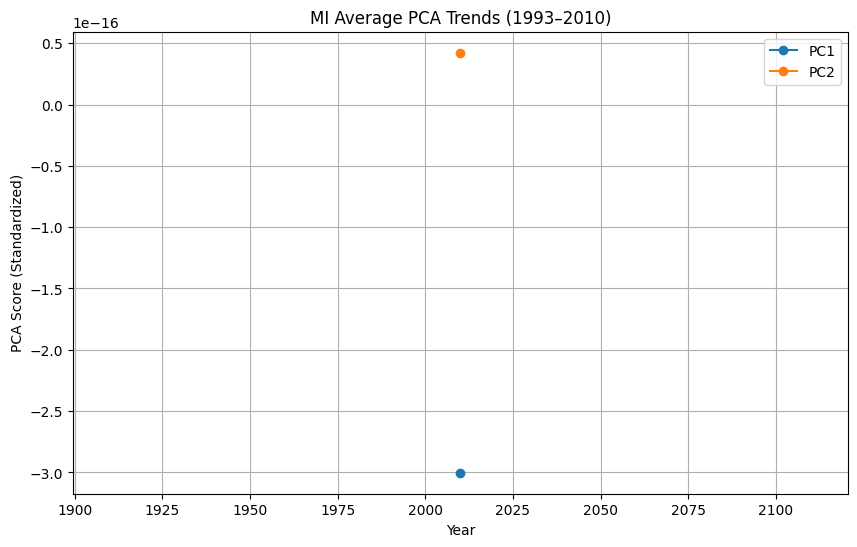

In [12]:
plt.figure(figsize=(10,6))
for pc in ["PC1", "PC2"]:
    yearly = pca_scores.groupby("survey_year")[pc].mean()
    plt.plot(yearly.index, yearly.values, marker="o", label=pc)

plt.title("MI Average PCA Trends (1993–2010)")
plt.xlabel("Year")
plt.ylabel("PCA Score (Standardized)")
plt.legend()
plt.grid(True)
plt.show()

In [8]:
econ_vars = [c for c in df.columns if "employment" in c or "unemployment" in c or "labor_force" in c]
health_vars = [
    "general_health_status - Excellent",
    "any_physical_activity - Yes",
    "ever_told_diabetes - Yes",
    "current_smoking_frequency - Every day"
]

corr = df[econ_vars + health_vars].corr().loc[econ_vars, health_vars]
print(corr)

KeyError: "['any_physical_activity - Yes', 'ever_told_diabetes - Yes', 'current_smoking_frequency - Every day'] not in index"

In [9]:
%pip install statsmodels

  Using cached patsy-1.0.1-py2.py3-none-any.whl.metadata (3.3 kB)
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 10.0/10.0 MB 22.4 MB/s  0:00:00eta 0:00:01
Using cached patsy-1.0.1-py2.py3-none-any.whl (232 kB)
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2/2 [statsmodels] [statsmodels]
Note: you may need to restart the kernel to use updated packages.


In [10]:
import statsmodels.api as sm

y = df["general_health_status - Excellent"]  # health outcome
X = df[["employment_mean", "unemployment_rate_mean"]]  # predictors
X = sm.add_constant(X)

model = sm.OLS(y, X).fit()
print(model.summary())

                                    OLS Regression Results                                   
Dep. Variable:     general_health_status - Excellent   R-squared:                       0.004
Model:                                           OLS   Adj. R-squared:                 -0.025
Method:                                Least Squares   F-statistic:                    0.1522
Date:                               Wed, 01 Oct 2025   Prob (F-statistic):              0.859
Time:                                       22:05:43   Log-Likelihood:                -238.53
No. Observations:                                 71   AIC:                             483.1
Df Residuals:                                     68   BIC:                             489.9
Df Model:                                          2                                         
Covariance Type:                           nonrobust                                         
                             coef    std err          t     

In [11]:
import matplotlib.pyplot as plt

outcomes = {
    "general_health_status - Excellent": "Excellent health",
    "any_physical_activity - Yes": "Physical activity",
    "ever_told_diabetes - Yes": "Diabetes prevalence",
    "current_smoking_frequency - Every day": "Daily smoking"
}

coefs = {}
for outcome, label in outcomes.items():
    y = df[outcome]
    X = df[["unemployment_rate_mean"]]
    from sklearn.linear_model import LinearRegression
    model = LinearRegression().fit(X, y)
    coefs[label] = model.coef_[0]

plt.barh(list(coefs.keys()), list(coefs.values()), color="salmon")
plt.axvline(0, color="black", linewidth=1)
plt.title("Effect of Unemployment on Health Outcomes (1993–2010)")
plt.xlabel("Coefficient (change in % outcome per 1% unemployment)")
plt.show()

KeyError: 'any_physical_activity - Yes'

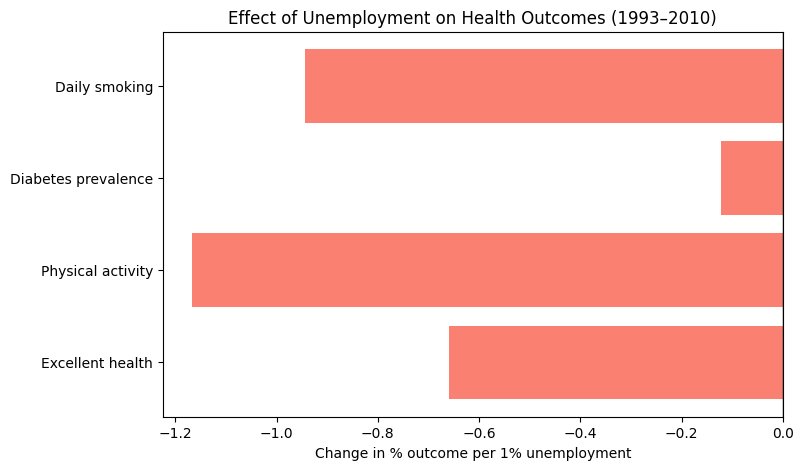

In [ ]:
import matplotlib.pyplot as plt
from sklearn.linear_model import LinearRegression

# Health outcomes to test
outcomes = {
    "general_health_status - Excellent": "Excellent health",
    "any_physical_activity - Yes": "Physical activity",
    "ever_told_diabetes - Yes": "Diabetes prevalence",
    "current_smoking_frequency - Every day": "Daily smoking"
}

coefs = {}
for outcome, label in outcomes.items():
    y = df[outcome]
    X = df[["unemployment_rate_mean"]]
    
    model = LinearRegression().fit(X, y)
    coefs[label] = model.coef_[0]

# Plot coefficients
plt.figure(figsize=(8,5))
plt.barh(list(coefs.keys()), list(coefs.values()), color="salmon")
plt.axvline(0, color="black", linewidth=1)
plt.title("Effect of Unemployment on Health Outcomes (1993–2010)")
plt.xlabel("Change in % outcome per 1% unemployment")
plt.show()

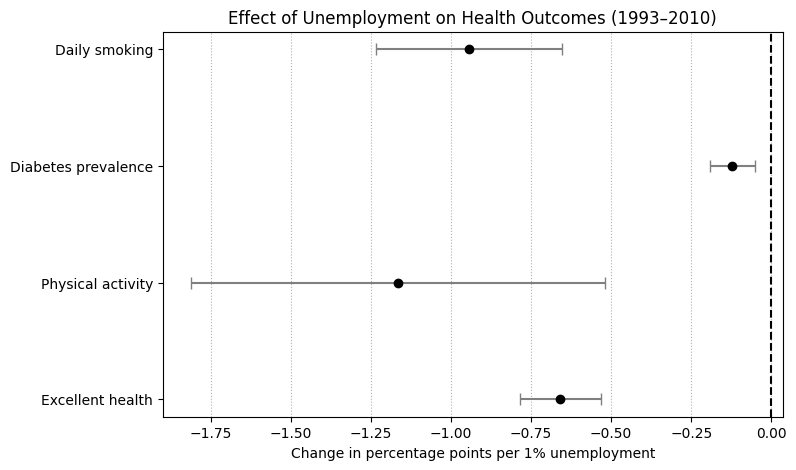

In [ ]:
import statsmodels.api as sm
import matplotlib.pyplot as plt

outcomes = {
    "general_health_status - Excellent": "Excellent health",
    "any_physical_activity - Yes": "Physical activity",
    "ever_told_diabetes - Yes": "Diabetes prevalence",
    "current_smoking_frequency - Every day": "Daily smoking"
}

results = {}
for outcome, label in outcomes.items():
    y = df[outcome]
    X = sm.add_constant(df[["unemployment_rate_mean"]])
    model = sm.OLS(y, X).fit()
    coef = model.params["unemployment_rate_mean"]
    ci_low, ci_high = model.conf_int().loc["unemployment_rate_mean"]
    results[label] = (coef, ci_low, ci_high)

labels, coefs, ci_lows, ci_highs = zip(*[(k, v[0], v[1], v[2]) for k,v in results.items()])

plt.figure(figsize=(8,5))
plt.errorbar(coefs, labels, xerr=[np.array(coefs)-np.array(ci_lows), np.array(ci_highs)-np.array(coefs)],
             fmt="o", color="black", ecolor="gray", capsize=4)
plt.axvline(0, color="black", linestyle="--")
plt.title("Effect of Unemployment on Health Outcomes (1993–2010)")
plt.xlabel("Change in percentage points per 1% unemployment")
plt.grid(True, axis="x", linestyle=":")
plt.show()

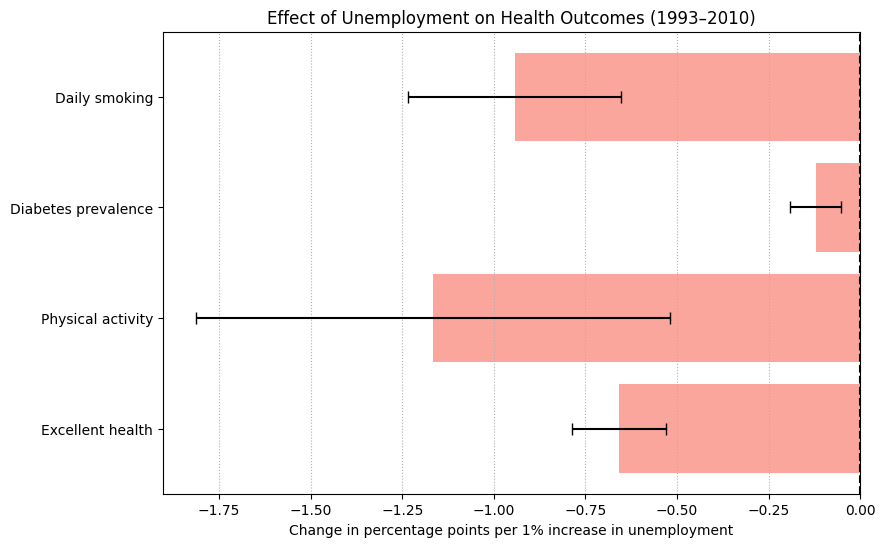

In [ ]:
import statsmodels.api as sm
import numpy as np
import matplotlib.pyplot as plt

# Define health outcomes of interest
outcomes = {
    "general_health_status - Excellent": "Excellent health",
    "any_physical_activity - Yes": "Physical activity",
    "ever_told_diabetes - Yes": "Diabetes prevalence",
    "current_smoking_frequency - Every day": "Daily smoking"
}

results = {}
for outcome, label in outcomes.items():
    y = df[outcome]
    X = sm.add_constant(df[["unemployment_rate_mean"]])
    model = sm.OLS(y, X).fit()
    coef = model.params["unemployment_rate_mean"]
    ci_low, ci_high = model.conf_int().loc["unemployment_rate_mean"]
    results[label] = (coef, ci_low, ci_high)

# Organize results
labels, coefs, ci_lows, ci_highs = zip(*[(k, v[0], v[1], v[2]) for k,v in results.items()])

# Plot
plt.figure(figsize=(9,6))
bars = plt.barh(labels, coefs, xerr=[np.array(coefs)-np.array(ci_lows), np.array(ci_highs)-np.array(coefs)],
                color="salmon", alpha=0.7, ecolor="black", capsize=4)

plt.axvline(0, color="black", linestyle="--")
plt.title("Effect of Unemployment on Health Outcomes (1993–2010)")
plt.xlabel("Change in percentage points per 1% increase in unemployment")
plt.grid(True, axis="x", linestyle=":")

plt.show()

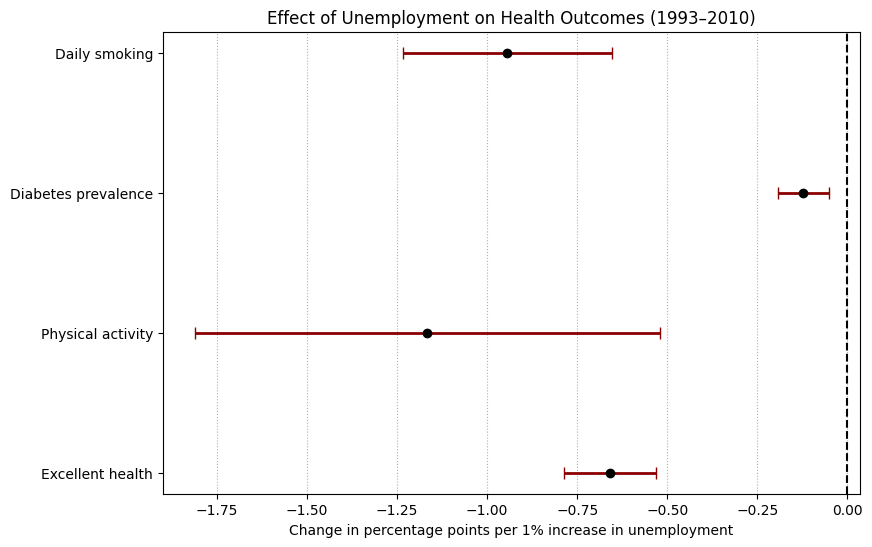

In [75]:
import statsmodels.api as sm
import numpy as np
import matplotlib.pyplot as plt

# Define health outcomes of interest
outcomes = {
    "general_health_status - Excellent": "Excellent health",
    "any_physical_activity - Yes": "Physical activity",
    "ever_told_diabetes - Yes": "Diabetes prevalence",
    "current_smoking_frequency - Every day": "Daily smoking"
}

results = {}
for outcome, label in outcomes.items():
    y = df[outcome]
    X = sm.add_constant(df[["unemployment_rate_mean"]])
    model = sm.OLS(y, X).fit()
    coef = model.params["unemployment_rate_mean"]
    ci_low, ci_high = model.conf_int().loc["unemployment_rate_mean"]
    results[label] = (coef, ci_low, ci_high)

# Organize for plotting
labels, coefs, ci_lows, ci_highs = zip(*[(k, v[0], v[1], v[2]) for k,v in results.items()])

plt.figure(figsize=(9,6))
plt.errorbar(coefs, labels,
             xerr=[np.array(coefs)-np.array(ci_lows), np.array(ci_highs)-np.array(coefs)],
             fmt="o", color="black", ecolor="darkred", elinewidth=2, capsize=4)

plt.axvline(0, color="black", linestyle="--")
plt.title("Effect of Unemployment on Health Outcomes (1993–2010)")
plt.xlabel("Change in percentage points per 1% increase in unemployment")
plt.grid(True, axis="x", linestyle=":")
plt.show()

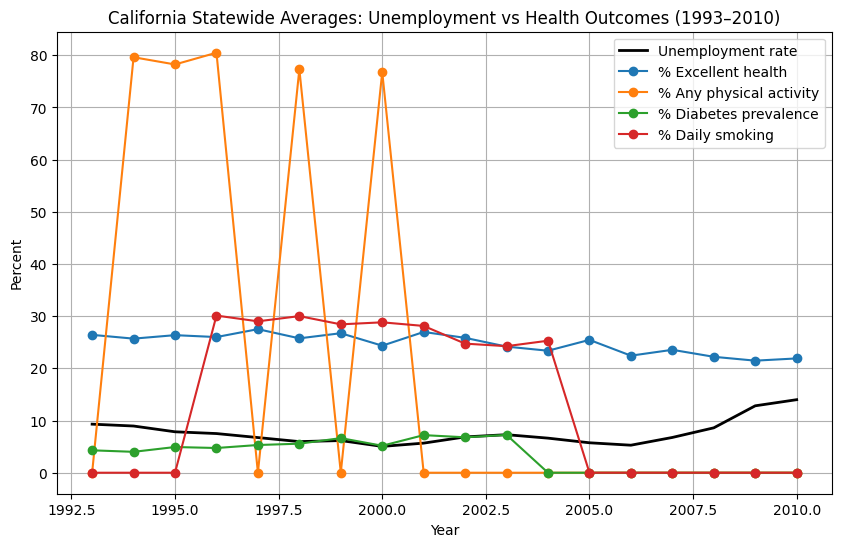

In [55]:
# Pick key variables
trend_vars = {
    "general_health_status - Excellent": "% Excellent health",
    "any_physical_activity - Yes": "% Any physical activity",
    "ever_told_diabetes - Yes": "% Diabetes prevalence",
    "current_smoking_frequency - Every day": "% Daily smoking"
}

# Compute statewide averages by year
trend = df.groupby("survey_year")[["unemployment_rate_mean"] + list(trend_vars.keys())].mean()

plt.figure(figsize=(10,6))

# Plot unemployment
plt.plot(trend.index, trend["unemployment_rate_mean"], label="Unemployment rate", color="black", linewidth=2)

# Plot health variables
for col, label in trend_vars.items():
    plt.plot(trend.index, trend[col], marker="o", label=label)

plt.title("California Statewide Averages: Unemployment vs Health Outcomes (1993–2010)")
plt.xlabel("Year")
plt.ylabel("Percent")
plt.legend()
plt.grid(True)
plt.show()

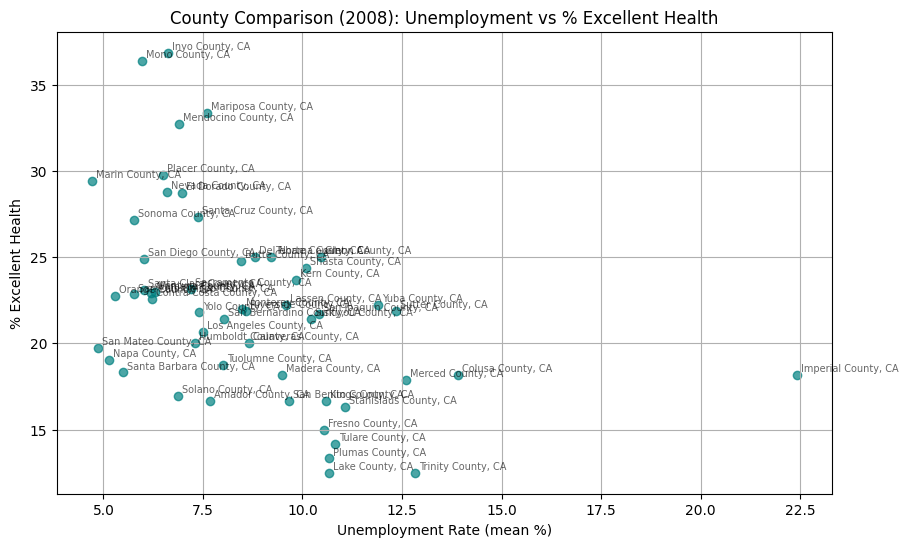

In [57]:
year = 2008  # you can change this to 2005, 2010, etc.
subset = df[df["survey_year"] == year]

plt.figure(figsize=(10,6))
plt.scatter(
    subset["unemployment_rate_mean"], 
    subset["general_health_status - Excellent"], 
    alpha=0.7, color="teal"
)

# Label counties
for i, row in subset.iterrows():
    plt.text(
        row["unemployment_rate_mean"]+0.1, 
        row["general_health_status - Excellent"]+0.2, 
        row["county_name"], fontsize=7, alpha=0.6
    )

plt.title(f"County Comparison ({year}): Unemployment vs % Excellent Health")
plt.xlabel("Unemployment Rate (mean %)")
plt.ylabel("% Excellent Health")
plt.grid(True)
plt.show()

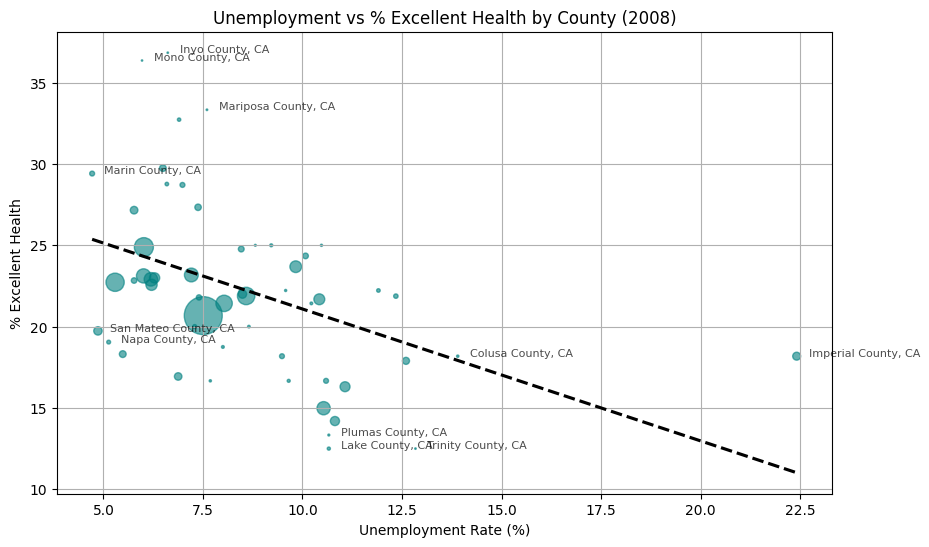

In [83]:
import matplotlib.pyplot as plt
import seaborn as sns

year = 2008
subset = df[df["survey_year"] == year].copy()

# If population data exists, use it. Otherwise, fake with labor force size as proxy
subset["pop_weight"] = subset["labor_force_mean"]  # proxy for population

plt.figure(figsize=(10,6))

# Scatter with population-scaled bubbles
sns.regplot(
    x="unemployment_rate_mean", 
    y="general_health_status - Excellent", 
    data=subset, scatter=False, color="black", ci=None, line_kws={"linestyle":"--"}
)

plt.scatter(
    subset["unemployment_rate_mean"], 
    subset["general_health_status - Excellent"], 
    s=subset["pop_weight"]/500,  # scale size
    alpha=0.6, color="teal"
)

# Label only extreme counties (top/bottom 3 unemployment and health)
top_unemp = subset.nlargest(3, "unemployment_rate_mean")
low_unemp = subset.nsmallest(3, "unemployment_rate_mean")
top_health = subset.nlargest(3, "general_health_status - Excellent")
low_health = subset.nsmallest(3, "general_health_status - Excellent")

highlight = pd.concat([top_unemp, low_unemp, top_health, low_health]).drop_duplicates()

for i, row in highlight.iterrows():
    plt.text(row["unemployment_rate_mean"]+0.3,
             row["general_health_status - Excellent"],
             row["county_name"], fontsize=8, alpha=0.7)

plt.title(f"Unemployment vs % Excellent Health by County ({year})")
plt.xlabel("Unemployment Rate (%)")
plt.ylabel("% Excellent Health")
plt.grid(True)
plt.show()

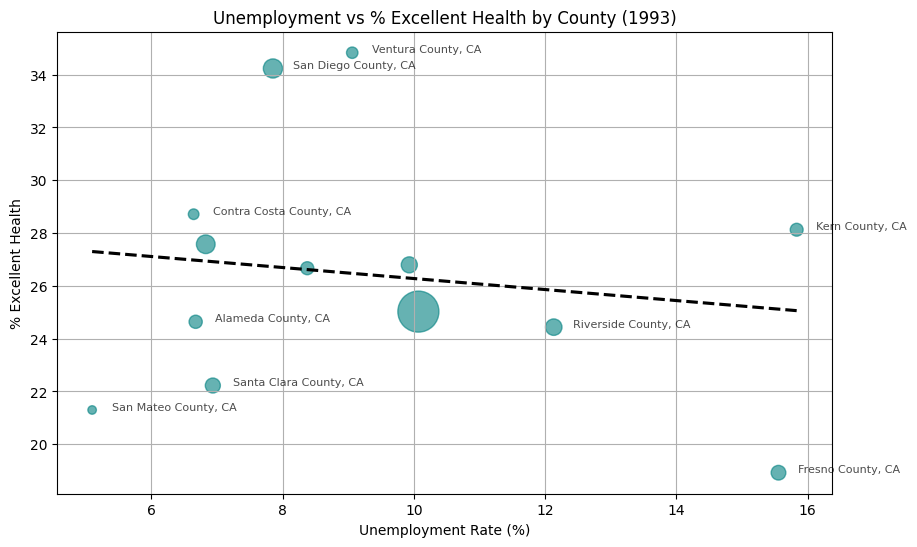

In [115]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import seaborn as sns
from IPython.display import HTML

years = sorted(df["survey_year"].unique())

fig, ax = plt.subplots(figsize=(10,6))

def update(year):
    ax.clear()
    subset = df[df["survey_year"] == year].copy()
    subset["pop_weight"] = subset["labor_force_mean"]

    # Regression line
    sns.regplot(
        x="unemployment_rate_mean", 
        y="general_health_status - Excellent", 
        data=subset, scatter=False, color="black", ci=None, 
        line_kws={"linestyle":"--"}, ax=ax
    )

    # Bubbles
    ax.scatter(
        subset["unemployment_rate_mean"], 
        subset["general_health_status - Excellent"], 
        s=subset["pop_weight"]/500, alpha=0.6, color="teal"
    )

    # Label extreme counties
    top_unemp = subset.nlargest(3, "unemployment_rate_mean")
    low_unemp = subset.nsmallest(3, "unemployment_rate_mean")
    top_health = subset.nlargest(3, "general_health_status - Excellent")
    low_health = subset.nsmallest(3, "general_health_status - Excellent")
    highlight = pd.concat([top_unemp, low_unemp, top_health, low_health]).drop_duplicates()

    for _, row in highlight.iterrows():
        ax.text(row["unemployment_rate_mean"]+0.3,
                row["general_health_status - Excellent"],
                row["county_name"], fontsize=8, alpha=0.7)

    ax.set_title(f"Unemployment vs % Excellent Health by County ({year})")
    ax.set_xlabel("Unemployment Rate (%)")
    ax.set_ylabel("% Excellent Health")
    ax.grid(True)

ani = animation.FuncAnimation(fig, update, frames=years, interval=1000, repeat=True)

# Render inline as HTML5 animation
HTML(ani.to_jshtml())

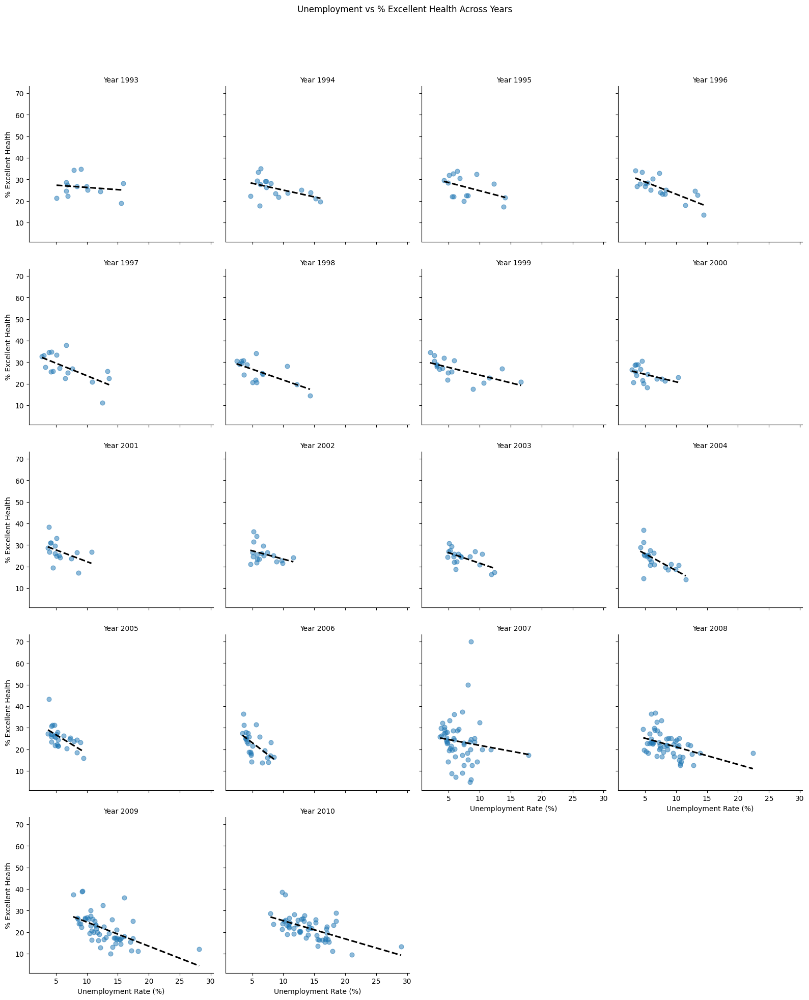

In [117]:
g = sns.lmplot(
    x="unemployment_rate_mean", 
    y="general_health_status - Excellent", 
    col="survey_year", 
    col_wrap=4,   # 4 plots per row
    data=df, 
    scatter_kws={"s": 40, "alpha": 0.5}, 
    line_kws={"linestyle": "--", "color": "black"},
    ci=None, height=4
)

g.set_axis_labels("Unemployment Rate (%)", "% Excellent Health")
g.set_titles("Year {col_name}")
plt.subplots_adjust(top=0.9)
g.fig.suptitle("Unemployment vs % Excellent Health Across Years")
plt.show()

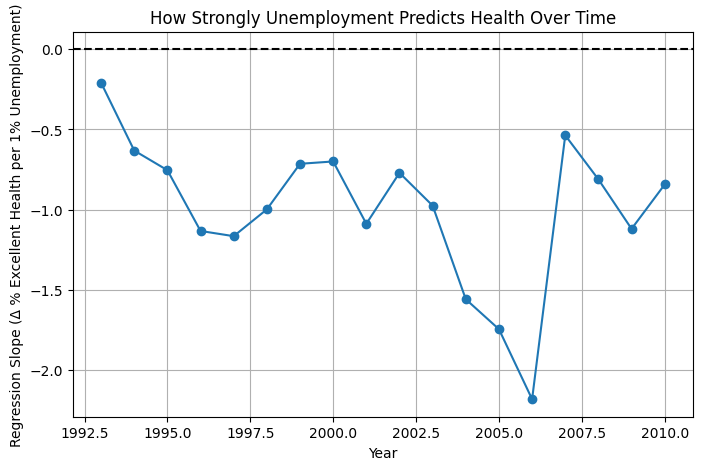

In [119]:
import statsmodels.api as sm

slopes = []
for year in sorted(df["survey_year"].unique()):
    subset = df[df["survey_year"] == year]
    X = sm.add_constant(subset["unemployment_rate_mean"])
    y = subset["general_health_status - Excellent"]
    model = sm.OLS(y, X).fit()
    slopes.append({"year": year, "slope": model.params["unemployment_rate_mean"]})

slopes_df = pd.DataFrame(slopes)

plt.figure(figsize=(8,5))
plt.plot(slopes_df["year"], slopes_df["slope"], marker="o")
plt.axhline(0, color="black", linestyle="--")
plt.title("How Strongly Unemployment Predicts Health Over Time")
plt.xlabel("Year")
plt.ylabel("Regression Slope (Δ % Excellent Health per 1% Unemployment)")
plt.grid(True)
plt.show()

In [61]:
%pip install seaborn

Note: you may need to restart the kernel to use updated packages.


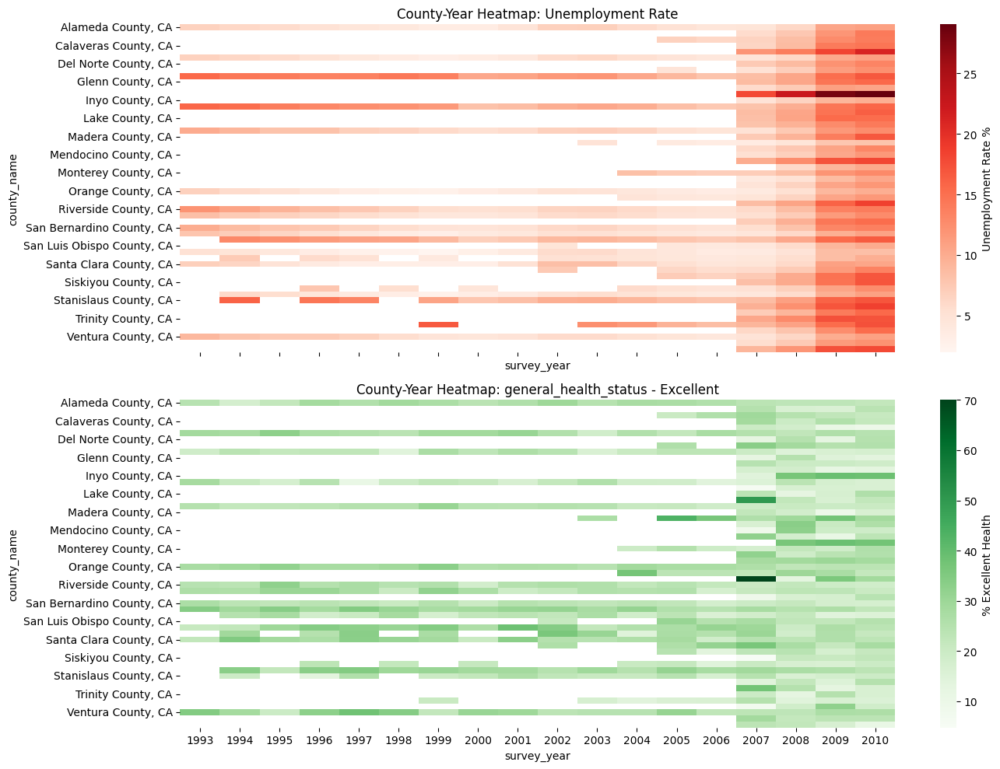

In [63]:
import seaborn as sns
import matplotlib.pyplot as plt

# Choose outcome to compare with unemployment
health_var = "general_health_status - Excellent"

# Pivot tables: counties × years
unemp_pivot = df.pivot_table(index="county_name", columns="survey_year", values="unemployment_rate_mean")
health_pivot = df.pivot_table(index="county_name", columns="survey_year", values=health_var)

fig, axes = plt.subplots(2, 1, figsize=(14,10), sharex=True)

# Heatmap for unemployment
sns.heatmap(unemp_pivot, cmap="Reds", ax=axes[0], cbar_kws={'label': 'Unemployment Rate %'})
axes[0].set_title("County-Year Heatmap: Unemployment Rate")

# Heatmap for health
sns.heatmap(health_pivot, cmap="Greens", ax=axes[1], cbar_kws={'label': '% Excellent Health'})
axes[1].set_title(f"County-Year Heatmap: {health_var}")

plt.tight_layout()
plt.show()

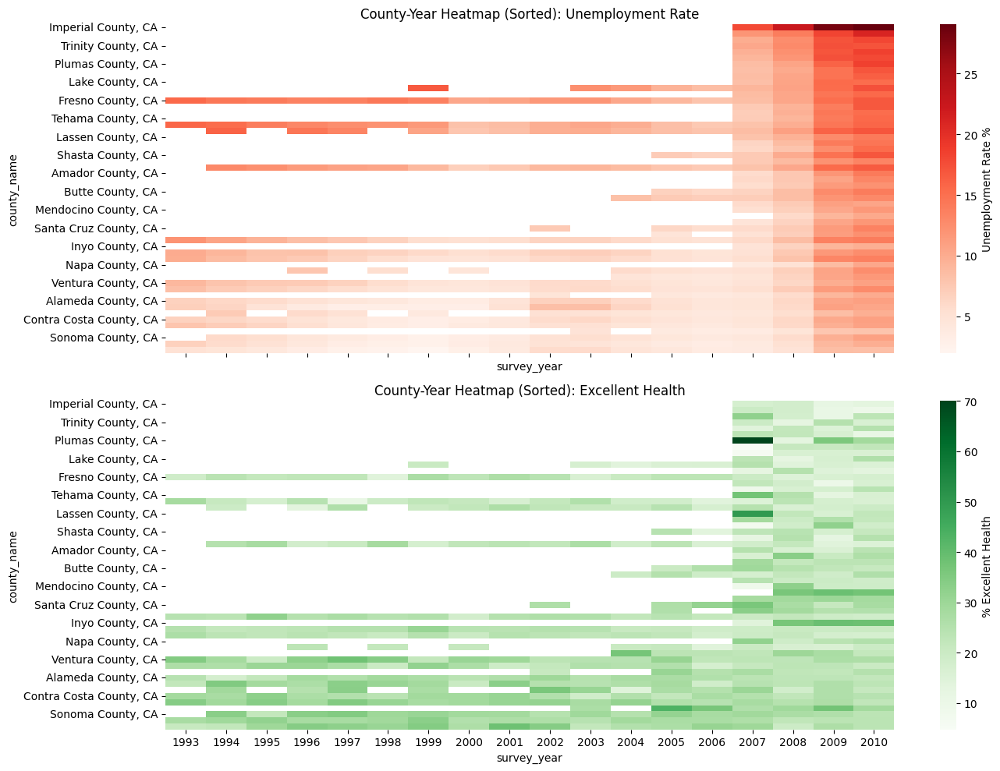

In [121]:
import seaborn as sns
import matplotlib.pyplot as plt

# Compute average unemployment across years per county
county_order = (
    df.groupby("county_name")["unemployment_rate_mean"]
    .mean()
    .sort_values(ascending=False)  # highest unemployment at top
    .index
)

# Pivot tables for unemployment & health
unemp_pivot = df.pivot_table(
    index="county_name", columns="survey_year", values="unemployment_rate_mean"
).loc[county_order]

health_pivot = df.pivot_table(
    index="county_name", columns="survey_year", values="general_health_status - Excellent"
).loc[county_order]

# Plot side-by-side heatmaps
fig, axes = plt.subplots(2, 1, figsize=(14, 10), sharex=True)

sns.heatmap(unemp_pivot, cmap="Reds", ax=axes[0], cbar_kws={'label': 'Unemployment Rate %'})
axes[0].set_title("County-Year Heatmap (Sorted): Unemployment Rate")

sns.heatmap(health_pivot, cmap="Greens", ax=axes[1], cbar_kws={'label': '% Excellent Health'})
axes[1].set_title("County-Year Heatmap (Sorted): Excellent Health")

plt.tight_layout()
plt.show()

In [133]:
import folium
import pandas as pd

# Pick a year
year = 2008
subset = df[df["survey_year"] == year]

# Load GeoJSON from GitHub
url = "https://raw.githubusercontent.com/codeforamerica/click_that_hood/master/public/data/california-counties.geojson"

# Create map centered on CA
m = folium.Map(location=[37.5, -119.5], zoom_start=6)

# Choropleth unemployment
folium.Choropleth(
    geo_data=url,
    data=subset,
    columns=["county_name", "unemployment_rate_mean"],
    key_on="feature.properties.name",  # join on county name
    fill_color="YlOrRd",
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name="Unemployment Rate (%)"
).add_to(m)

m

In [129]:
pip install folium

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3/3 [folium]
Note: you may need to restart the kernel to use updated packages.


In [135]:
subset = df[df["survey_year"] == year].copy()

# Clean county names to match GeoJSON
subset["county_clean"] = subset["county_name"].str.replace(" County, CA", "", regex=False)

m = folium.Map(location=[37.5, -119.5], zoom_start=6)

folium.Choropleth(
    geo_data=url,
    data=subset,
    columns=["county_clean", "unemployment_rate_mean"],
    key_on="feature.properties.name",   # matches "Alameda", "Fresno" etc.
    fill_color="YlOrRd",
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name="Unemployment Rate (%)"
).add_to(m)

m

In [137]:
columns=["county_clean", "unemployment_rate_mean"]

In [139]:
# Subset for the year
year = 2008
subset = df[df["survey_year"] == year].copy()
subset["county_clean"] = subset["county_name"].str.replace(" County, CA", "", regex=False)

m = folium.Map(location=[37.5, -119.5], zoom_start=6)

# Unemployment choropleth
folium.Choropleth(
    geo_data=url,
    data=subset,
    columns=["county_clean", "unemployment_rate_mean"],
    key_on="feature.properties.name",
    fill_color="YlOrRd",
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name="Unemployment Rate (%)",
    name="Unemployment"
).add_to(m)

# Health choropleth
folium.Choropleth(
    geo_data=url,
    data=subset,
    columns=["county_clean", "general_health_status - Excellent"],
    key_on="feature.properties.name",
    fill_color="Greens",
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name="% Excellent Health",
    name="Health"
).add_to(m)

# Layer control toggle
folium.LayerControl().add_to(m)

m

In [141]:
import numpy as np

year = 2008
subset = df[df["survey_year"] == year].copy()
subset["county_clean"] = subset["county_name"].str.replace(" County, CA", "", regex=False)

# Normalize both unemployment and health
subset["unemp_norm"] = pd.qcut(subset["unemployment_rate_mean"], 3, labels=[0,1,2]).astype(int)
subset["health_norm"] = pd.qcut(subset["general_health_status - Excellent"], 3, labels=[0,1,2]).astype(int)

# Combine into bivariate index
subset["bivariate"] = subset["unemp_norm"].astype(str) + subset["health_norm"].astype(str)

# Define custom color mapping
bivariate_colors = {
    "20": "#d73027",  # high unemployment, low health
    "21": "#f46d43",
    "22": "#fdae61",
    "10": "#abdda4",
    "11": "#74add1",
    "12": "#4575b4",
    "00": "#1a9850",  # low unemployment, high health
    # etc: adjust palette
}
subset["color"] = subset["bivariate"].map(bivariate_colors)

# Build map
m = folium.Map(location=[37.5, -119.5], zoom_start=6)
for _, row in subset.iterrows():
    folium.GeoJson(
        url,
        style_function=lambda feature, row=row: {
            'fillColor': row["color"],
            'color': 'black',
            'weight': 0.5,
            'fillOpacity': 0.7,
        },
        tooltip=f"{row['county_clean']}: Unemp {row['unemployment_rate_mean']:.1f}%, Health {row['general_health_status - Excellent']:.1f}%"
    ).add_to(m)

m

In [143]:
year = 2008
subset = df[df["survey_year"] == year].copy()

# Strip " County, CA" so names match GeoJSON
subset["county_clean"] = subset["county_name"].str.replace(" County, CA", "", regex=False)

m = folium.Map(location=[37.5, -119.5], zoom_start=6)

folium.Choropleth(
    geo_data=url,
    data=subset,
    columns=["county_clean", "general_health_status - Excellent"],  # or unemployment_rate_mean
    key_on="feature.properties.name",   # GeoJSON field
    fill_color="YlGn",
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name="% Excellent Health"
).add_to(m)

m

In [145]:
import folium

year = 2008
subset = df[df["survey_year"] == year].copy()
subset["county_clean"] = subset["county_name"].str.replace(" County, CA", "", regex=False)

# Create map
m = folium.Map(location=[37.5, -119.5], zoom_start=6)

# Choropleth base = unemployment
folium.Choropleth(
    geo_data=url,
    data=subset,
    columns=["county_clean", "unemployment_rate_mean"],
    key_on="feature.properties.name",
    fill_color="YlOrRd",
    fill_opacity=0.7,
    line_opacity=0.2,
    legend_name="Unemployment Rate (%)"
).add_to(m)

# Add circle markers for health
for _, row in subset.iterrows():
    if "latitude" in row and "longitude" in row:
        folium.CircleMarker(
            location=[row["latitude"], row["longitude"]],   # need county centroids
            radius=row["general_health_status - Excellent"] / 2,  # scale size
            color="green",
            fill=True,
            fill_opacity=0.6,
            popup=f"{row['county_clean']}: {row['general_health_status - Excellent']:.1f}% Excellent Health"
        ).add_to(m)

m

/var/folders/_x/0nzdc1vn503crjmfc8pg76y40000gr/T/ipykernel_97335/3868937933.py:8: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  df.groupby(["survey_year", "unemp_quartile"])["general_health_status - Excellent"]


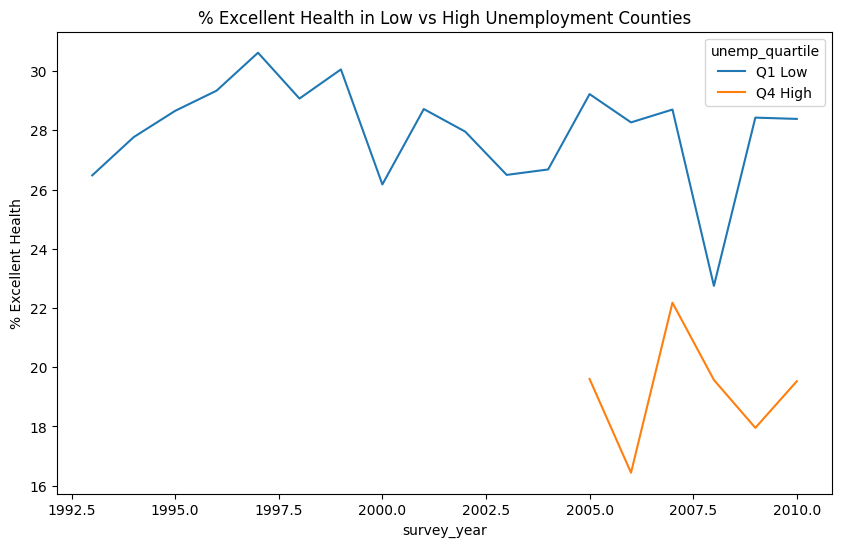

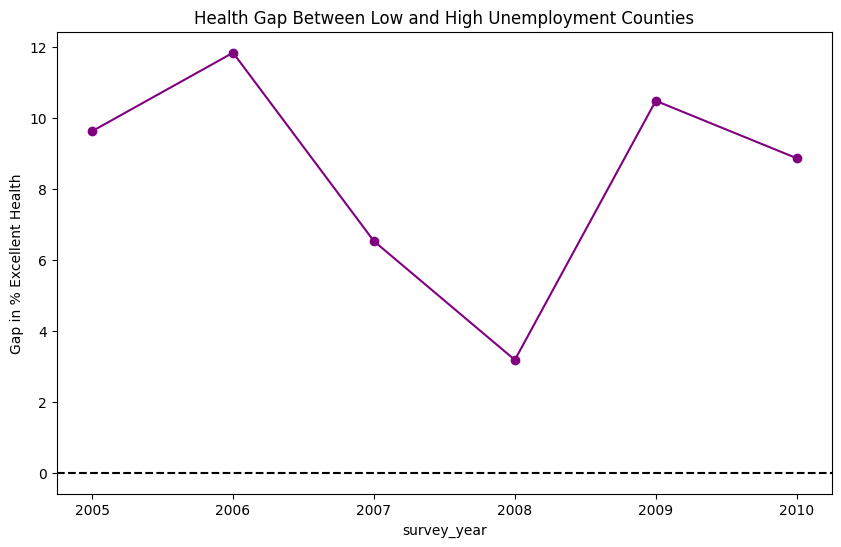

In [123]:
# Compute yearly averages by quartile
df["unemp_quartile"] = pd.qcut(
    df.groupby("survey_year")["unemployment_rate_mean"].rank(method="first"),
    4, labels=["Q1 Low", "Q2", "Q3", "Q4 High"]
)

quartile_trends = (
    df.groupby(["survey_year", "unemp_quartile"])["general_health_status - Excellent"]
    .mean()
    .unstack()
)

# Compute gap: low unemployment counties - high unemployment counties
quartile_trends["Health Gap (Low - High)"] = quartile_trends["Q1 Low"] - quartile_trends["Q4 High"]

# Plot
quartile_trends[["Q1 Low","Q4 High"]].plot(figsize=(10,6))
plt.title("% Excellent Health in Low vs High Unemployment Counties")
plt.ylabel("% Excellent Health")
plt.show()

quartile_trends["Health Gap (Low - High)"].plot(figsize=(10,6), color="purple", marker="o")
plt.title("Health Gap Between Low and High Unemployment Counties")
plt.ylabel("Gap in % Excellent Health")
plt.axhline(0, color="black", linestyle="--")
plt.show()

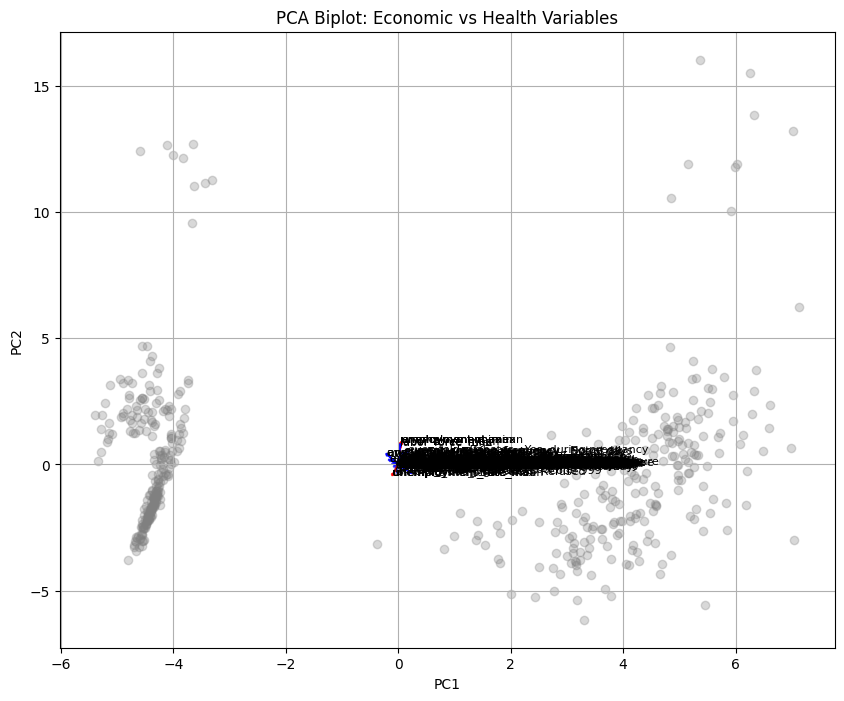

In [65]:
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA

# Prepare numeric data
X = df.drop(columns=["county_name", "survey_year"])
X_scaled = StandardScaler().fit_transform(X)

# Run PCA
pca = PCA(n_components=2)
X_pca = pca.fit_transform(X_scaled)

# Scores (county-year points)
pca_scores = pd.DataFrame(X_pca, columns=["PC1", "PC2"])
pca_scores["county_name"] = df["county_name"]
pca_scores["survey_year"] = df["survey_year"]

# Loadings (arrows for variables)
loadings = pd.DataFrame(
    pca.components_.T,
    columns=["PC1", "PC2"],
    index=X.columns
)

# Plot counties
plt.figure(figsize=(10,8))
plt.scatter(pca_scores["PC1"], pca_scores["PC2"], alpha=0.3, color="gray")
plt.title("PCA Biplot: Economic vs Health Variables")
plt.xlabel("PC1")
plt.ylabel("PC2")

# Draw arrows for top contributing variables
scaling_factor = 3  # makes arrows visible
for var in loadings.index:
    x, y = loadings.loc[var, "PC1"], loadings.loc[var, "PC2"]
    plt.arrow(0, 0, x*scaling_factor, y*scaling_factor, 
              color="red" if "employment" in var or "unemployment" in var else "blue",
              alpha=0.7, head_width=0.05)
    plt.text(x*scaling_factor*1.1, y*scaling_factor*1.1, var, fontsize=8)

plt.grid(True)
plt.show()

In [151]:
print(loadings.index.tolist())

['any_alcohol_past_month - Yes', 'any_alcohol_past_month - No', 'any_alcohol_past_month - Don’t know/Not sure', 'any_alcohol_past_month - Refused', 'any_physical_activity - Yes', 'any_physical_activity - No', 'any_physical_activity - Don’t know/Not sure', 'current_smoking_frequency - Every day', 'current_smoking_frequency - Some days', 'current_smoking_frequency - Not at all', 'current_smoking_frequency - Refused', 'eats_fruit - 1 times/day', 'eats_fruit - 2 times/day', 'eats_fruit - 3 times/day', 'eats_fruit - 4 times/day', 'eats_fruit - 5 times/day', 'eats_fruit - 6 times/day', 'eats_fruit - 7 times/day', 'eats_fruit - 8 times/day', 'eats_fruit - 9 times/day', 'eats_fruit - 10 times/day', 'eats_fruit - 20 times/day', 'eats_fruit - 30 times/day', 'eats_fruit - 53 times/day', 'eats_fruit - 1 times/week', 'eats_fruit - 2 times/week', 'eats_fruit - 3 times/week', 'eats_fruit - 4 times/week', 'eats_fruit - 5 times/week', 'eats_fruit - 6 times/week', 'eats_fruit - 7 times/week', 'eats_frui

In [153]:
# Economic variables (last block in your list)
econ_vars = [
    "employment_mean", "employment_min", "employment_max",
    "unemployment_mean", "unemployment_min", "unemployment_max",
    "labor_force_mean", "labor_force_min", "labor_force_max",
    "unemployment_rate_mean", "unemployment_rate_min", "unemployment_rate_max"
]

# Health variables = everything else in loadings
health_vars = [col for col in loadings.index if col not in econ_vars]

# Compute group average loadings
econ_vector = loadings.loc[econ_vars].mean()
health_vector = loadings.loc[health_vars].mean()

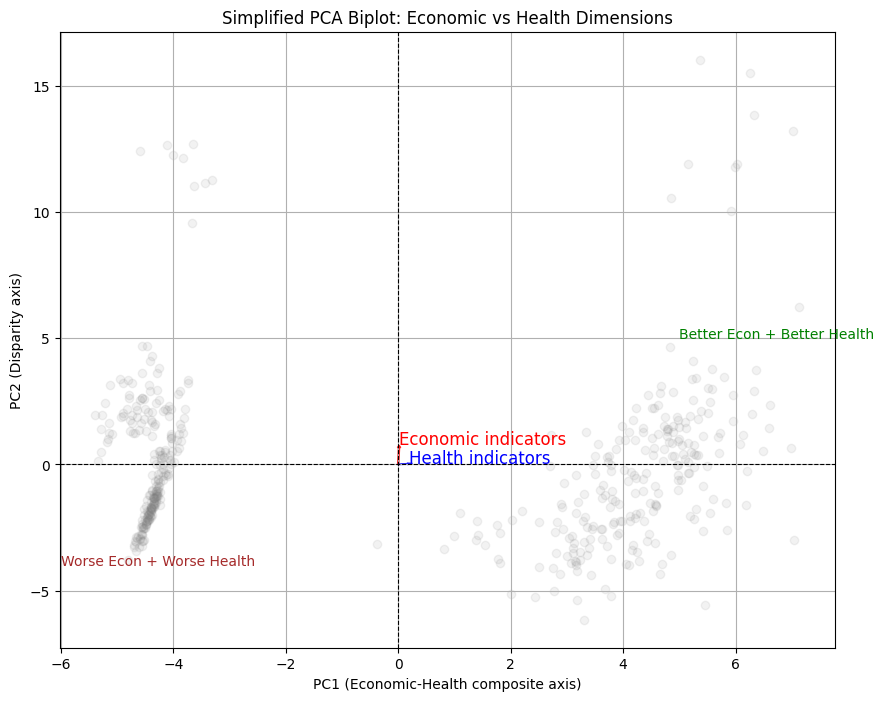

In [155]:
plt.figure(figsize=(10,8))

# Plot faint gray points for all county-years
plt.scatter(pca_scores["PC1"], pca_scores["PC2"], alpha=0.1, color="gray")

# Draw economic vector
scaling_factor = 4
plt.arrow(0,0, econ_vector["PC1"]*scaling_factor, econ_vector["PC2"]*scaling_factor,
          color="red", width=0.02, alpha=0.8)
plt.text(econ_vector["PC1"]*scaling_factor*1.2,
         econ_vector["PC2"]*scaling_factor*1.2,
         "Economic indicators", fontsize=12, color="red")

# Draw health vector
plt.arrow(0,0, health_vector["PC1"]*scaling_factor, health_vector["PC2"]*scaling_factor,
          color="blue", width=0.02, alpha=0.8)
plt.text(health_vector["PC1"]*scaling_factor*1.2,
         health_vector["PC2"]*scaling_factor*1.2,
         "Health indicators", fontsize=12, color="blue")

# Add quadrant guide
plt.axhline(0, color="black", linestyle="--", lw=0.8)
plt.axvline(0, color="black", linestyle="--", lw=0.8)
plt.text(5, 5, "Better Econ + Better Health", fontsize=10, color="green")
plt.text(-6, -4, "Worse Econ + Worse Health", fontsize=10, color="brown")

plt.title("Simplified PCA Biplot: Economic vs Health Dimensions")
plt.xlabel("PC1 (Economic-Health composite axis)")
plt.ylabel("PC2 (Disparity axis)")
plt.grid(True)
plt.show()

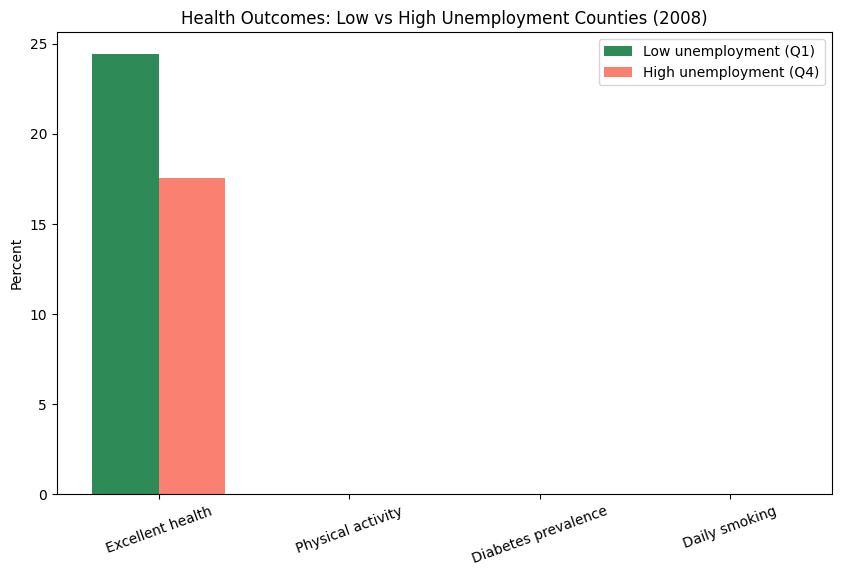

In [67]:
import numpy as np
import matplotlib.pyplot as plt

# Pick year for snapshot (e.g., recession year)
year = 2008
subset = df[df["survey_year"] == year].copy()

# Define unemployment quartiles
q1 = subset["unemployment_rate_mean"].quantile(0.25)
q3 = subset["unemployment_rate_mean"].quantile(0.75)

low_unemp = subset[subset["unemployment_rate_mean"] <= q1]
high_unemp = subset[subset["unemployment_rate_mean"] >= q3]

# Health outcomes to compare
health_vars = {
    "general_health_status - Excellent": "Excellent health",
    "any_physical_activity - Yes": "Physical activity",
    "ever_told_diabetes - Yes": "Diabetes prevalence",
    "current_smoking_frequency - Every day": "Daily smoking"
}

# Compute averages
low_means = low_unemp[list(health_vars.keys())].mean()
high_means = high_unemp[list(health_vars.keys())].mean()

# Plot
x = np.arange(len(health_vars))
width = 0.35

plt.figure(figsize=(10,6))
plt.bar(x - width/2, low_means, width, label="Low unemployment (Q1)", color="seagreen")
plt.bar(x + width/2, high_means, width, label="High unemployment (Q4)", color="salmon")

plt.xticks(x, health_vars.values(), rotation=20)
plt.ylabel("Percent")
plt.title(f"Health Outcomes: Low vs High Unemployment Counties ({year})")
plt.legend()
plt.show()

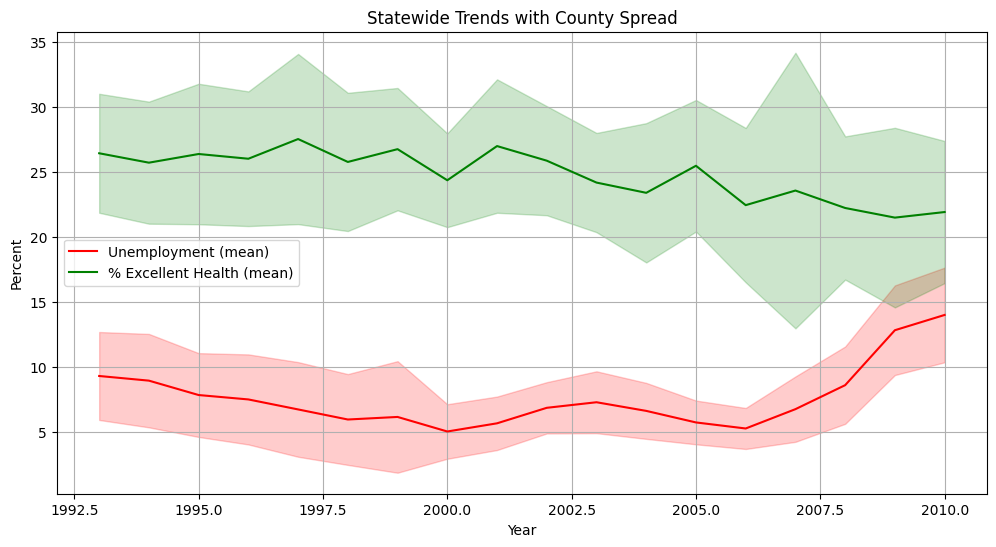

In [69]:
import matplotlib.pyplot as plt

# Pick health outcome
health_var = "general_health_status - Excellent"

# Compute yearly mean and std across counties
spread = df.groupby("survey_year")[[health_var, "unemployment_rate_mean"]].agg(["mean", "std"])

years = spread.index

plt.figure(figsize=(12,6))

# Unemployment
plt.plot(years, spread["unemployment_rate_mean"]["mean"], color="red", label="Unemployment (mean)")
plt.fill_between(years,
                 spread["unemployment_rate_mean"]["mean"] - spread["unemployment_rate_mean"]["std"],
                 spread["unemployment_rate_mean"]["mean"] + spread["unemployment_rate_mean"]["std"],
                 color="red", alpha=0.2)

# Health
plt.plot(years, spread[health_var]["mean"], color="green", label="% Excellent Health (mean)")
plt.fill_between(years,
                 spread[health_var]["mean"] - spread[health_var]["std"],
                 spread[health_var]["mean"] + spread[health_var]["std"],
                 color="green", alpha=0.2)

plt.title("Statewide Trends with County Spread")
plt.xlabel("Year")
plt.ylabel("Percent")
plt.legend()
plt.grid(True)
plt.show()

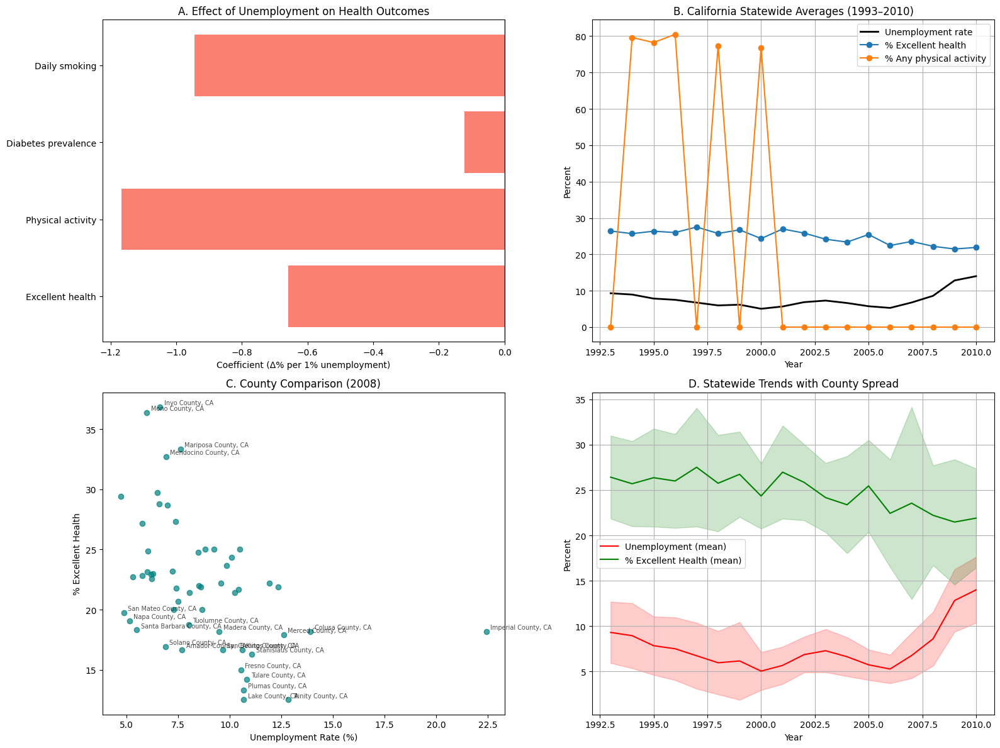

In [71]:
import matplotlib.pyplot as plt
from sklearn.linear_model import LinearRegression
import numpy as np

fig, axes = plt.subplots(2, 2, figsize=(16,12))

# -----------------------------
# Panel A: Coefficient plot
# -----------------------------
outcomes = {
    "general_health_status - Excellent": "Excellent health",
    "any_physical_activity - Yes": "Physical activity",
    "ever_told_diabetes - Yes": "Diabetes prevalence",
    "current_smoking_frequency - Every day": "Daily smoking"
}

coefs = {}
for outcome, label in outcomes.items():
    y = df[outcome]
    X = df[["unemployment_rate_mean"]]
    model = LinearRegression().fit(X, y)
    coefs[label] = model.coef_[0]

axes[0,0].barh(list(coefs.keys()), list(coefs.values()), color="salmon")
axes[0,0].axvline(0, color="black", linewidth=1)
axes[0,0].set_title("A. Effect of Unemployment on Health Outcomes")
axes[0,0].set_xlabel("Coefficient (Δ% per 1% unemployment)")

# -----------------------------
# Panel B: Statewide trends
# -----------------------------
trend_vars = {
    "general_health_status - Excellent": "% Excellent health",
    "any_physical_activity - Yes": "% Any physical activity"
}
trend = df.groupby("survey_year")[["unemployment_rate_mean"] + list(trend_vars.keys())].mean()
axes[0,1].plot(trend.index, trend["unemployment_rate_mean"], label="Unemployment rate", color="black", linewidth=2)
for col, label in trend_vars.items():
    axes[0,1].plot(trend.index, trend[col], marker="o", label=label)
axes[0,1].set_title("B. California Statewide Averages (1993–2010)")
axes[0,1].set_xlabel("Year")
axes[0,1].set_ylabel("Percent")
axes[0,1].legend()
axes[0,1].grid(True)

# -----------------------------
# Panel C: County scatter (2008)
# -----------------------------
year = 2008
subset = df[df["survey_year"] == year]
axes[1,0].scatter(subset["unemployment_rate_mean"], subset["general_health_status - Excellent"], alpha=0.7, color="teal")
axes[1,0].set_title(f"C. County Comparison ({year})")
axes[1,0].set_xlabel("Unemployment Rate (%)")
axes[1,0].set_ylabel("% Excellent Health")

# Highlight outliers
for i, row in subset.iterrows():
    if row["general_health_status - Excellent"] < 20 or row["general_health_status - Excellent"] > 30:
        axes[1,0].text(row["unemployment_rate_mean"]+0.2, row["general_health_status - Excellent"]+0.2, 
                       row["county_name"], fontsize=7, alpha=0.7)

# -----------------------------
# Panel D: Spread plot
# -----------------------------
health_var = "general_health_status - Excellent"
spread = df.groupby("survey_year")[[health_var, "unemployment_rate_mean"]].agg(["mean", "std"])
years = spread.index

axes[1,1].plot(years, spread["unemployment_rate_mean"]["mean"], color="red", label="Unemployment (mean)")
axes[1,1].fill_between(years,
                       spread["unemployment_rate_mean"]["mean"] - spread["unemployment_rate_mean"]["std"],
                       spread["unemployment_rate_mean"]["mean"] + spread["unemployment_rate_mean"]["std"],
                       color="red", alpha=0.2)

axes[1,1].plot(years, spread[health_var]["mean"], color="green", label="% Excellent Health (mean)")
axes[1,1].fill_between(years,
                       spread[health_var]["mean"] - spread[health_var]["std"],
                       spread[health_var]["mean"] + spread[health_var]["std"],
                       color="green", alpha=0.2)

axes[1,1].set_title("D. Statewide Trends with County Spread")
axes[1,1].set_xlabel("Year")
axes[1,1].set_ylabel("Percent")
axes[1,1].legend()
axes[1,1].grid(True)

plt.tight_layout()
plt.show()

In [157]:
df["poor_health_index"] = (
    df["general_health_status - Fair"] + df["general_health_status - Poor"] +
    df["any_physical_activity - No"] +
    df["current_smoking_frequency - Every day"] +
    df["ever_told_diabetes - Yes"]
) / 5

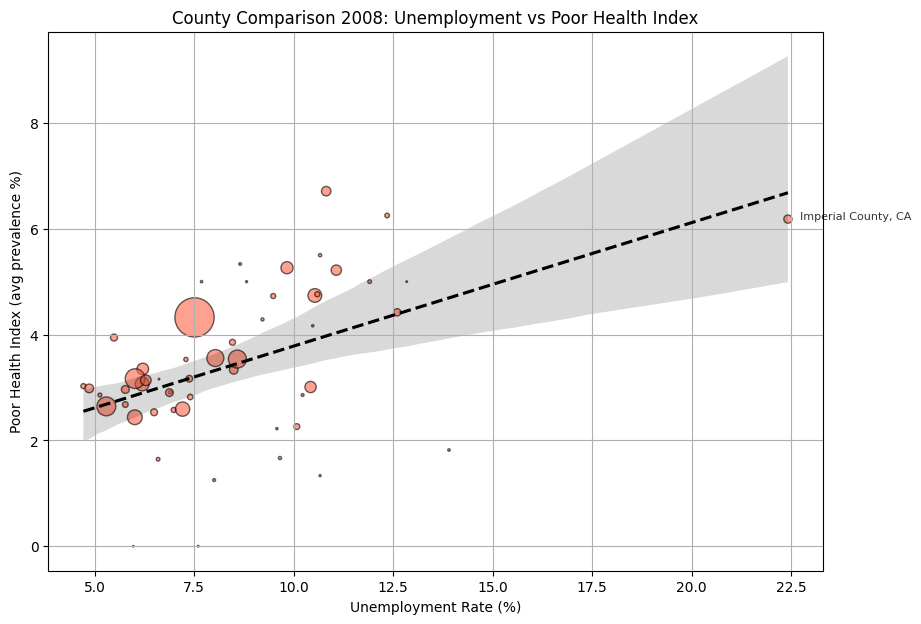

In [159]:
import matplotlib.pyplot as plt
import seaborn as sns

year = 2008
subset = df[df["survey_year"] == year].copy()
subset["pop_weight"] = subset["labor_force_mean"] / subset["labor_force_mean"].max() * 800

plt.figure(figsize=(10,7))

# Scatter with population scaling
plt.scatter(
    subset["unemployment_rate_mean"],
    subset["poor_health_index"],
    s=subset["pop_weight"], alpha=0.6, color="tomato", edgecolor="k"
)

# Regression line
sns.regplot(
    x="unemployment_rate_mean",
    y="poor_health_index",
    data=subset,
    scatter=False, ci=95, color="black", line_kws={"linestyle":"--"}
)

# Label key outliers
highlight = subset[
    (subset["poor_health_index"] > 25) | (subset["unemployment_rate_mean"] > 15)
]
for _, row in highlight.iterrows():
    plt.text(
        row["unemployment_rate_mean"]+0.3,
        row["poor_health_index"],
        row["county_name"],
        fontsize=8, alpha=0.8
    )

plt.title(f"County Comparison {year}: Unemployment vs Poor Health Index")
plt.xlabel("Unemployment Rate (%)")
plt.ylabel("Poor Health Index (avg prevalence %)")
plt.grid(True)
plt.show()